In [1]:
pip install plotly.express

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
import datetime
import plotly.express as px
pd.options.plotting.backend = "plotly"

In [3]:
#import data
intraday_data = pd.read_csv('sushan_intraday_data.csv')
daily_data = pd.read_csv('sushan_daily.csv', parse_dates=['DATE'])

In [4]:
#convert dates from string into datetime
intraday_data['datetime'] = intraday_data['date'] + ' ' + intraday_data['time']
intraday_data['datetime'] = pd.to_datetime(intraday_data['datetime'])
intraday_data['date'] = pd.to_datetime(intraday_data['date'])

intraday_data['symbol'] = intraday_data['sym_root'] + intraday_data['sym_suffix']
intraday_data.loc[intraday_data['sym_suffix'].isnull(), 'symbol'] = intraday_data['sym_root']

In [5]:
#filter for daily and intraday data by stock, then merge into one df
sym_vol = {}

#for sym in intraday_data['symbol'].unique():
intra = intraday_data.loc[intraday_data['symbol'] == 'QCOM']
daily = daily_data.loc[daily_data['symbol'] == 'QCOM']
df = intra.merge(daily[['DATE', 'symbol', 'total_vol_m']], how='left', left_on=['date', 'symbol'], right_on = ['DATE', 'symbol'])
df.index = pd.DatetimeIndex(df['datetime'])
df.drop(columns=['DATE','datetime'], inplace=True)
df = df.between_time('09:31:00', '15:59:00')
df['%_vol'] = df['size']/df['total_vol_m']
sym_vol['QCOM'] = df

In [6]:
df.head()

,date,time,sym_root,sym_suffix,size,symbol,total_vol_m,%_vol
datetime,,,,,,,,
2019-01-02 09:31:00,2019-01-02,09:31:00,QCOM,NaN,86785.0,QCOM,9469007.0,0.009165
2019-01-02 09:32:00,2019-01-02,09:32:00,QCOM,NaN,119364.0,QCOM,9469007.0,0.012606
2019-01-02 09:33:00,2019-01-02,09:33:00,QCOM,NaN,50269.0,QCOM,9469007.0,0.005309
2019-01-02 09:34:00,2019-01-02,09:34:00,QCOM,NaN,87034.0,QCOM,9469007.0,0.009191
2019-01-02 09:35:00,2019-01-02,09:35:00,QCOM,NaN,89024.0,QCOM,9469007.0,0.009402


In [7]:
df.to_csv('qcom_merged_data.csv',index=False)

In [8]:
(df['%_vol'] >1).any()

False

In [9]:
(df['%_vol'] <0).any()

False

In [94]:
s = intraday_data['symbol'].unique()[3]
s

'QCOM'

In [10]:
def plot_u_curve(symbol):
    '''Generate u_curve based on 180 day average intraday volume'''
    
    #groupby time to calculate 180-day rolling average volume
    df = sym_vol[s].groupby(sym_vol[s].index.time)['%_vol'].rolling(180).mean()
    
    #ungroup, then sort df by date and time
    df = df.reset_index()
    df.rename(columns={'level_0':'time', '%_vol': 'avg_%_vol'}, inplace=True)
    df['date'] = df['datetime'].dt.date
    df = df.sort_values(['date', 'time'], ascending=(True, True)).set_index(['date', 'time'])
    df.drop(columns=['datetime'], inplace=True)
    
    #convert date from row index to column index
    df = df.unstack().transpose()
    df.index = df.index.droplevel(0)
    
    #plot df
    fig = df.plot()
    fig.show()

In [96]:
plot_u_curve('QCOM')

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd

# beta fit

In [26]:
from scipy.stats import beta
import matplotlib.pyplot as plt
import seaborn as sns
a = 1.774733
b = 790.287873


In [24]:
df['%_vol'] = df['%_vol'].dropna()

In [25]:
df

,date,time,sym_root,sym_suffix,size,symbol,total_vol_m,%_vol
datetime,,,,,,,,
2019-01-02 09:31:00,2019-01-02,09:31:00,QCOM,NaN,86785.0,QCOM,9469007.0,0.009165
2019-01-02 09:32:00,2019-01-02,09:32:00,QCOM,NaN,119364.0,QCOM,9469007.0,0.012606
2019-01-02 09:33:00,2019-01-02,09:33:00,QCOM,NaN,50269.0,QCOM,9469007.0,0.005309
2019-01-02 09:34:00,2019-01-02,09:34:00,QCOM,NaN,87034.0,QCOM,9469007.0,0.009191
2019-01-02 09:35:00,2019-01-02,09:35:00,QCOM,NaN,89024.0,QCOM,9469007.0,0.009402
...,...,...,...,...,...,...,...,...
2021-12-31 15:55:00,2021-12-31,15:55:00,QCOM,NaN,59746.0,QCOM,3911478.0,0.015275
2021-12-31 15:56:00,2021-12-31,15:56:00,QCOM,NaN,68935.0,QCOM,3911478.0,0.017624
2021-12-31 15:57:00,2021-12-31,15:57:00,QCOM,NaN,61240.0,QCOM,3911478.0,0.015656


/Users/zss/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:639: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.0, 0.02)

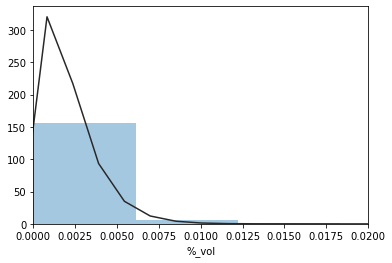

In [58]:
from scipy.stats import beta
ax = sns.distplot(df['%_vol'], fit=beta, kde=False)
plt.xlim(0,0.02)

In [54]:
x = np.linspace(beta.ppf(0.01, a, b),
                beta.ppf(0.99, a, b), 293536)
beta.pdf(x, a, b)

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)


array([132.04539669, 132.06337621, 132.08135399, ...,   7.11008044,
         7.10995059,   7.10982074])

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:607: RuntimeWarning: divide by zero encountered in _beta_pdf
  return _boost._beta_pdf(x, a, b)


Text(0.5, 1.0, 'Qualcomm - Beta Distribution')

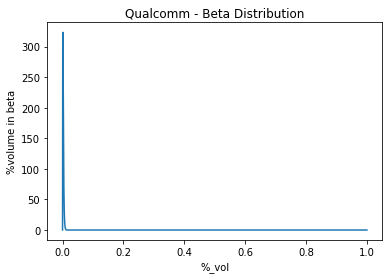

In [89]:
x = np.linspace(0, 1, 10000)
plt.plot(x, beta.pdf(x, a, b))
plt.xlabel('%_vol')
# naming the y axis
plt.ylabel('%volume in beta')
# giving a title to my graph
plt.title('Qualcomm - Beta Distribution')

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:607: RuntimeWarning: divide by zero encountered in _beta_pdf
  return _boost._beta_pdf(x, a, b)


(0.0, 0.02)

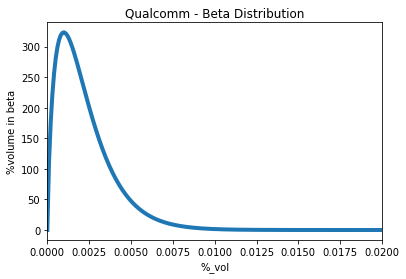

In [92]:
x = np.linspace(0, 1, 10000)
plt.plot(x, beta.pdf(x, a, b), linewidth = 4)
plt.xlabel('%_vol')
# naming the y axis
plt.ylabel('%volume in beta')
 
# giving a title to my graph
plt.title('Qualcomm - Beta Distribution')
plt.xlim(0,0.02)

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)


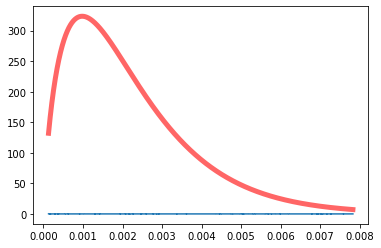

In [38]:
fig, ax = plt.subplots(1, 1)
x = np.linspace(beta.ppf(0.01, a, b),
                beta.ppf(0.99, a, b), 293536)
ax.plot(x, beta.pdf(x, a, b),
       'r-', lw=5, alpha=0.6, label='beta pdf')
rv = beta(a, b)
#ax.plot(x, rv.pdf(x), 'k-', lw=2, label='frozen pdf')
ax.plot(x, df['%_vol'], label = 'test')

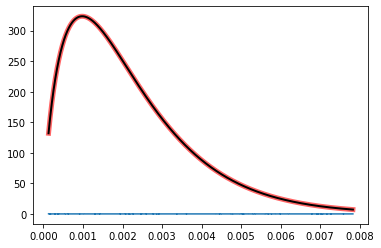

In [37]:
fig

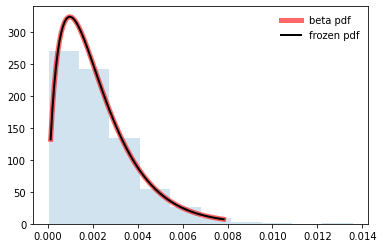

In [20]:
r = beta.rvs(a, b, size=1000)
ax.hist(r, density=True, histtype='stepfilled', alpha=0.2)
ax.legend(loc='best', frameon=False)
plt.show()
fig

/Users/zss/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:607: RuntimeWarning: divide by zero encountered in _beta_pdf
  return _boost._beta_pdf(x, a, b)


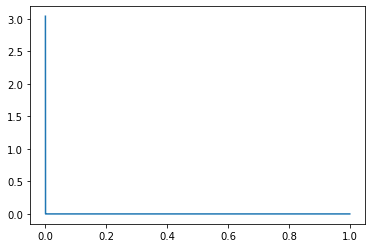

In [21]:
x = np.linspace(0, 1, 10000)
plt.plot(x, beta.pdf(x, mean, 20000))